In [1]:
import os
import random
import numpy as np
from tqdm import tqdm
import shutil
from IPython.display import HTML

import matplotlib
import matplotlib.pyplot as plt
import matplotlib.animation as animation
matplotlib.rcParams['figure.figsize'] = [5, 5]
matplotlib.rcParams['figure.dpi'] = 200

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.nn import init

import torchvision
import torchvision.transforms as transforms
import torchvision.utils as vutils

from data_helper_color_map import UnlabeledDataset, LabeledDataset
from helper import collate_fn, draw_box

In [2]:
random.seed(0)
np.random.seed(0)
torch.manual_seed(0);

device = ("cuda:0" if torch.cuda.is_available() else "cpu")

In [3]:
data_dir = '/home/alexander/data'
annotation_csv = '/home/alexander/data/annotation.csv'

resume_training_from_checkpoint = True
load_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar'
save_checkpoint_path = 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar'

In [4]:
def save_checkpoint(fpath, state):
    torch.save(state, fpath)
    
def print_sys_mem_usage():
    print("Memory usage (RAM):\n")
    !free -h
    print("\nGPU Memory Usage:\n")
    !nvidia-smi --query-gpu=memory.used --format=csv
    !nvidia-smi --query-gpu=memory.total --format=csv
    print("\n")
    
def print_train_stats(epoch, n_epochs, i, n_batches, loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post):
    print('Epoch: [%d/%d]\tBatch: [%d/%d]\n' % (epoch + 1, n_epochs, i, n_batches),
          'Loss_D: %.4f\tLoss_G: %.4f\n' % (loss_d_total.item(), loss_g_total.item()),
          'D(real): %.4f  ||  D(gen) Pre-step: %.4f  ||  D(gen) Post-step: %.4f\n' %
          (d_real_mean, d_gen_mean_pre, d_gen_mean_post))

### Set Initial Parameters

In [5]:
batch_size = 16

### Create Dataset and Dataloader

In [6]:
unlabeled_scene_index = np.arange(106)
labeled_scene_index_train = np.arange(106, 130)
labeled_scene_index_test = np.arange(130, 134)

In [7]:
labeled_trainset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_train,
                                  img_transform=transforms.Compose([transforms.Resize((256,256)),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

trainloader = torch.utils.data.DataLoader(labeled_trainset,
                                          batch_size=batch_size,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [8]:
labeled_trainset[1][0].size()

torch.Size([18, 256, 256])

In [9]:
for images, road_maps in trainloader:
    print(road_maps.size())
    break

torch.Size([16, 3, 256, 256])


### Define models

In [10]:
class ResnetBlock(nn.Module):
    """
    Define a Resnet block
    A resnet block is a conv block with skip connections
    Original Resnet paper: https://arxiv.org/pdf/1512.03385.pdf
    """
    def __init__(self, dim):
        """
        Parameters:
            dim (int)           -- the number of channels in the conv layer.
            padding_type (str)  -- the name of padding layer: reflect | replicate | zero
            use_dropout (bool)  -- if use dropout layers.
            use_bias (bool)     -- if the conv layer uses bias or not
        """
        super(ResnetBlock, self).__init__()
        self.resnet_block = nn.Sequential(nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim),
                                          nn.ReLU(True),
                                          nn.Dropout(0.5),
                                          nn.Conv2d(dim, dim, kernel_size=3, padding=1),
                                          nn.BatchNorm2d(dim)
                                         )
        
    def forward(self, x):
        return x + self.resnet_block(x)  # add skip connections

In [11]:
class Generator(nn.Module):
    """
    RESNET-based generator that consists of Resnet blocks + downsampling/upsampling operations.
    """
    def __init__(self, in_ch, out_ch, ngf, n_blocks=6, init_gain=0.02):
        """
        Parameters:
            in_ch (int)         -- the number of channels in input images
            out_ch (int)        -- the number of channels in output images
            ngf (int)           -- the number of filters in the last conv layer
            n_blocks (int)      -- the number of ResNet blocks
            padding_type (str)  -- the name of padding layer in conv layers: reflect | replicate | zero
        """        
        assert(n_blocks >= 0)
        super(Generator, self).__init__()
        
        self.model = nn.Sequential(
            nn.ReflectionPad2d(3),
            
            nn.Conv2d(in_ch, ngf, kernel_size=7, padding=0),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.Conv2d(ngf, ngf * 2, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            
            nn.Conv2d(ngf * 2, ngf * 4, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            
            ResnetBlock(ngf * 4),  #1
            ResnetBlock(ngf * 4),  #2
            ResnetBlock(ngf * 4),  #3
            ResnetBlock(ngf * 4),  #4
            ResnetBlock(ngf * 4),  #5
            ResnetBlock(ngf * 4),  #6
            ResnetBlock(ngf * 4),  #7
            ResnetBlock(ngf * 4),  #8
            ResnetBlock(ngf * 4),  #9

            nn.ConvTranspose2d(ngf * 4, int(ngf * 2), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf * 2)),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(ngf * 2, int(ngf), kernel_size=3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(int(ngf)),
            nn.ReLU(True),

            nn.ReflectionPad2d(3),
            nn.Conv2d(ngf, out_ch, kernel_size=7, padding=0),
            nn.Tanh()
        )
        
    def forward(self, x):
        return self.model(x)

In [12]:
class Discriminator(nn.Module):
    def __init__(self, in_ch, ndf=64, n_layers=3):  
        super(Discriminator, self).__init__()
        
        self.block1 = nn.Sequential(nn.Conv2d(in_ch, ndf, kernel_size=4, stride=2, padding=1),
                                    nn.LeakyReLU(0.2, True)
                                   )
        
        nf_mult = 1
        nf_mult_prev = 1
        sequence2 = []        
        for n in range(1, n_layers):  # gradually increase the number of filters
            nf_mult_prev = nf_mult
            nf_mult = min(2 ** n, 8)
            sequence2 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=2, padding=1),
                         nn.BatchNorm2d(ndf * nf_mult),
                         nn.LeakyReLU(0.2, True)
                         ]
        self.block2 = nn.Sequential(*sequence2)
        
        sequence3 = []
        nf_mult_prev = nf_mult
        nf_mult = min(2 ** n_layers, 8)
        sequence3 += [nn.Conv2d(ndf * nf_mult_prev, ndf * nf_mult, kernel_size=4, stride=1, padding=1),
                     nn.BatchNorm2d(ndf * nf_mult),
                     nn.LeakyReLU(0.2, True)
                     ]
        self.block3 = nn.Sequential(*sequence3)
        
        self.model = nn.Sequential(self.block1,
                                   self.block2,
                                   self.block3,
                                   nn.Conv2d(ndf * nf_mult, 1, kernel_size=4, stride=1, padding=1)
                                  )
        
    def forward(self, x):
        return self.model(x)

In [13]:
# # Sanity check - dimensions of inputs and outputs to both networks.

# test = torch.zeros([batch_size, 18, 256, 256])
# print("Input to generator:\t", test.size())

# test_generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02)
# test_result_g = test_generator(test)
# print("\nOutput of generator:\t", test_result_g.size())

# test_d_input = torch.cat((test_result_g, test), 1)
# print("\nInput to discriminator:\t", test_d_input.size())

# test_discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d)
# test_result_d = test_discriminator(test_d_input)
# print("\nOutput of discriminator:", test_result_d.size())

In [14]:
class GANLoss(nn.Module):
    """
    The GANLoss class abstracts away the need to create the target label tensor
    that has the same size as the input.
    """
    def __init__(self, gan_mode, real_label=1.0, gen_label=0.0):
        """
        Parameters:
            gan_mode (str) - - the type of GAN objective. It currently supports vanilla, lsgan, and wgangp.
            target_real_label (bool) - - label for a real image
            target_gen_label (bool) - - label of a generated image
        Note: Do not use sigmoid as the last layer of Discriminator.
        LSGAN needs no sigmoid. vanilla GANs will handle it with BCEWithLogitsLoss.
        """
        super(GANLoss, self).__init__()
        
        self.gan_mode = gan_mode
        self.real_label = real_label
        self.gen_label = gen_label
        
        if gan_mode == 'LS':
            self.loss = nn.MSELoss().to(device)
        elif gan_mode == 'BCE':
            self.loss = nn.BCEWithLogitsLoss().to(device)

    def get_target_tensor(self, output, target_is_real):
        # Create label tensors with same size as the discriminator output.
        if target_is_real:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.real_label])
            else:
                target_tensor = torch.Tensor([self.real_label])
        else:
            if "cuda" in device:
                target_tensor = torch.cuda.FloatTensor([self.gen_label])
            else:
                target_tensor = torch.Tensor([self.gen_label])
                
        return target_tensor.expand_as(output)

    def __call__(self, output, target_is_real):
        target_tensor = self.get_target_tensor(output, target_is_real)
        loss = self.loss(output, target_tensor)
        return loss

In [15]:
def init_weights(m):  # define the initialization function
    classname = m.__class__.__name__
    if hasattr(m, 'weight') and (classname.find('Conv') != -1 or classname.find('Linear') != -1):
        init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm2d') != -1:  # BatchNorm Layer's weight is not a matrix; only normal distribution applies.
        init.normal_(m.weight.data, 1.0, 0.02)
        init.constant_(m.bias.data, 0.0)

### Train

In [16]:
update_stats_rate = 25
debug_mem_usage = False
losses_g = []
losses_d = []
intermediate_images = []

In [17]:
in_ch = 18
out_ch = 3
ngf = 64
ndf = 64
n_blocks_g = 9
n_layers_d = 3

start_epoch = 0
n_epochs = 100
lr_g = 0.00005
lr_d = 0.0001
beta1 = 0.5
beta2 = 0.999
L1_lambda = 100

real_label = 1.0
gen_label = 0.0

In [18]:
generator = Generator(in_ch, out_ch, ngf, n_blocks=n_blocks_g, init_gain=0.02).to(device)
discriminator = Discriminator(in_ch + out_ch, ndf=ndf, n_layers=n_layers_d).to(device)

generator.apply(init_weights)
discriminator.apply(init_weights)

generator.train()
discriminator.train()


# We combine GAN Loss and L1 Loss to attain Total Loss
criterion_gan = GANLoss('BCE', real_label=real_label, gen_label=gen_label).to(device)
criterion_L1 = nn.L1Loss().to(device)

optim_G = torch.optim.Adam(generator.parameters(), lr=lr_g, betas=(beta1, beta2))
optim_D = torch.optim.Adam(discriminator.parameters(), lr=lr_d, betas=(beta1, beta2))

In [19]:
"""
Optional: Load checkpoint from most recent training run if resuming from previous trial.
"""
if resume_training_from_checkpoint:
    if os.path.isfile(load_checkpoint_path):
        print("=> loading checkpoint '{}'".format(load_checkpoint_path))
        
        checkpoint = torch.load(load_checkpoint_path)
        start_epoch = checkpoint['epoch']
        losses_g = checkpoint['losses_g']
        losses_d = checkpoint['losses_d']
        intermediate_images = checkpoint['intermediate_images']
        
        generator.load_state_dict(checkpoint['g_state_dict'])
        discriminator.load_state_dict(checkpoint['d_state_dict'])
        optim_G.load_state_dict(checkpoint['optim_g'])
        optim_D.load_state_dict(checkpoint['optim_d'])
        
        print("=> loaded checkpoint '{}' (epoch {})".format(load_checkpoint_path, checkpoint['epoch']))
    else:
        print("=> no checkpoint found at '{}'".format(load_checkpoint_path))

=> loading checkpoint 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar'
=> loaded checkpoint 'training_checkpoints/GANLossBCE_L1Loss_64feat_colormap_epoch_0to100_checkpoint_lowerLR.pth.tar' (epoch 68)


In [20]:
####################################
########## TRAINING LOOP ###########
####################################

n_batches = len(trainloader)
for epoch in range(start_epoch, n_epochs):
    iters = 1
    for real_18ch, real_map in tqdm(trainloader):
        """
        TRAIN DISCRIMINATOR ON BOTH REAL + GENERATED SAMPLES
        """
        real_18ch = real_18ch.to(device)
        real_map = real_map.to(device)
        
        gen_map = generator(real_18ch)
        
        real_19ch = torch.cat((real_18ch, real_map), 1).to(device)
        gen_19ch = torch.cat((real_18ch, gen_map), 1).to(device)

        output_real = discriminator(real_19ch)
        output_gen = discriminator(gen_19ch.detach())
        
        d_real_mean = output_real.mean().item()
        d_gen_mean_pre = output_gen.mean().item()

        # Make label tensors.
        target_real = torch.Tensor([real_label]).expand_as(output_real).to(device)
        target_gen = torch.Tensor([gen_label]).expand_as(output_gen).to(device)

        # Compute loss.
        loss_d_real = criterion_gan(output_real, target_is_real=True)
        loss_d_gen = criterion_gan(output_gen, target_is_real=False)
        loss_d_total = (loss_d_real + loss_d_gen)

        discriminator.zero_grad()
        loss_d_total.backward()
        optim_D.step()
        
        """
        TRAIN GENERATOR
        """
        output_gen = discriminator(gen_19ch)
        loss_g_gan = criterion_gan(output_gen, target_is_real=True)
        loss_g_L1 = L1_lambda * criterion_L1(gen_map, real_map)
        loss_g_total = loss_g_gan + loss_g_L1
        d_gen_mean_post = output_gen.mean().item()
        
        generator.zero_grad()
        loss_g_total.backward()
        optim_G.step()
        
        """
        COMPILE TRAINING STATISTICS
        """
        losses_d.append(loss_d_total.item())
        losses_g.append(loss_g_total.item())
        
        if iters % update_stats_rate == 1:
            print_train_stats(epoch, n_epochs, iters, n_batches,
                              loss_d_total, loss_g_total, d_real_mean, d_gen_mean_pre, d_gen_mean_post)

        iters += 1
    
    # Add generated image to intermediate images list.
    with torch.no_grad():
        gen_map = generator(real_18ch).detach().cpu()
    intermediate_images.append(vutils.make_grid(gen_map, normalize=True))
    
    save_checkpoint(save_checkpoint_path,
                    {'epoch': epoch + 1,
                     'g_state_dict': generator.state_dict(),
                     'd_state_dict': discriminator.state_dict(),
                     'optim_g' : optim_G.state_dict(),
                     'optim_d' : optim_D.state_dict(),
                     'losses_g' : losses_g,
                     'losses_d' : losses_d,
                     'intermediate_images' : intermediate_images,                     
                    })
    
    if debug_mem_usage and epoch % 10 == 0:
        print_sys_mem_usage()

  1%|          | 1/189 [00:03<09:30,  3.03s/it]

Epoch: [69/100]	Batch: [1/189]
 Loss_D: 0.1183	Loss_G: 11.5462
 D(real): 3.7586  ||  D(gen) Pre-step: -2.7864  ||  D(gen) Post-step: -2.9368



 14%|█▍        | 26/189 [00:29<02:40,  1.02it/s]

Epoch: [69/100]	Batch: [26/189]
 Loss_D: 0.3694	Loss_G: 12.1086
 D(real): 3.8001  ||  D(gen) Pre-step: -1.3888  ||  D(gen) Post-step: -4.6567



 27%|██▋       | 51/189 [00:55<02:35,  1.12s/it]

Epoch: [69/100]	Batch: [51/189]
 Loss_D: 2.7947	Loss_G: 6.9105
 D(real): -2.5504  ||  D(gen) Pre-step: -4.5885  ||  D(gen) Post-step: 0.6050



 40%|████      | 76/189 [01:21<01:49,  1.03it/s]

Epoch: [69/100]	Batch: [76/189]
 Loss_D: 0.6248	Loss_G: 8.5699
 D(real): 1.9519  ||  D(gen) Pre-step: -1.0265  ||  D(gen) Post-step: -2.2170



 53%|█████▎    | 101/189 [01:47<01:39,  1.13s/it]

Epoch: [69/100]	Batch: [101/189]
 Loss_D: 0.1758	Loss_G: 8.9083
 D(real): 2.5995  ||  D(gen) Pre-step: -2.7002  ||  D(gen) Post-step: -3.0025



 67%|██████▋   | 126/189 [02:13<01:03,  1.01s/it]

Epoch: [69/100]	Batch: [126/189]
 Loss_D: 0.2447	Loss_G: 9.4755
 D(real): 1.6516  ||  D(gen) Pre-step: -3.8946  ||  D(gen) Post-step: -3.2126



 80%|███████▉  | 151/189 [02:38<00:37,  1.03it/s]

Epoch: [69/100]	Batch: [151/189]
 Loss_D: 1.4919	Loss_G: 10.6653
 D(real): 5.9925  ||  D(gen) Pre-step: 1.1154  ||  D(gen) Post-step: -4.5318



 93%|█████████▎| 176/189 [03:04<00:13,  1.03s/it]

Epoch: [69/100]	Batch: [176/189]
 Loss_D: 0.2883	Loss_G: 11.6949
 D(real): 3.8857  ||  D(gen) Pre-step: -1.4632  ||  D(gen) Post-step: -3.5942



  1%|          | 1/189 [00:02<08:26,  2.69s/it]

Epoch: [70/100]	Batch: [1/189]
 Loss_D: 0.2332	Loss_G: 7.6315
 D(real): 3.8000  ||  D(gen) Pre-step: -1.9350  ||  D(gen) Post-step: -2.5347



 14%|█▍        | 26/189 [00:26<02:33,  1.06it/s]

Epoch: [70/100]	Batch: [26/189]
 Loss_D: 1.1215	Loss_G: 6.6356
 D(real): -0.5513  ||  D(gen) Pre-step: -4.3689  ||  D(gen) Post-step: -0.7585



 27%|██▋       | 51/189 [00:51<02:22,  1.03s/it]

Epoch: [70/100]	Batch: [51/189]
 Loss_D: 0.2008	Loss_G: 9.0950
 D(real): 3.0742  ||  D(gen) Pre-step: -2.1587  ||  D(gen) Post-step: -2.4656



 40%|████      | 76/189 [01:16<01:51,  1.02it/s]

Epoch: [70/100]	Batch: [76/189]
 Loss_D: 0.3305	Loss_G: 11.1724
 D(real): 5.0636  ||  D(gen) Pre-step: -1.1836  ||  D(gen) Post-step: -3.3822



 53%|█████▎    | 101/189 [01:41<01:29,  1.02s/it]

Epoch: [70/100]	Batch: [101/189]
 Loss_D: 0.3598	Loss_G: 10.2935
 D(real): 2.5112  ||  D(gen) Pre-step: -3.6249  ||  D(gen) Post-step: -3.1785



 67%|██████▋   | 126/189 [02:05<01:00,  1.05it/s]

Epoch: [70/100]	Batch: [126/189]
 Loss_D: 0.2111	Loss_G: 8.0430
 D(real): 2.1565  ||  D(gen) Pre-step: -3.0708  ||  D(gen) Post-step: -2.1617



 80%|███████▉  | 151/189 [02:29<00:38,  1.02s/it]

Epoch: [70/100]	Batch: [151/189]
 Loss_D: 0.1893	Loss_G: 10.4193
 D(real): 4.7972  ||  D(gen) Pre-step: -2.2564  ||  D(gen) Post-step: -3.1250



 93%|█████████▎| 176/189 [02:53<00:12,  1.08it/s]

Epoch: [70/100]	Batch: [176/189]
 Loss_D: 0.1371	Loss_G: 9.8365
 D(real): 2.6854  ||  D(gen) Pre-step: -3.3219  ||  D(gen) Post-step: -2.6357



  1%|          | 1/189 [00:02<08:00,  2.56s/it]

Epoch: [71/100]	Batch: [1/189]
 Loss_D: 0.4424	Loss_G: 8.9302
 D(real): 2.1804  ||  D(gen) Pre-step: -2.3061  ||  D(gen) Post-step: -2.9528



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [71/100]	Batch: [26/189]
 Loss_D: 0.1306	Loss_G: 10.7600
 D(real): 4.3953  ||  D(gen) Pre-step: -2.4621  ||  D(gen) Post-step: -2.7731



 27%|██▋       | 51/189 [00:50<02:17,  1.01it/s]

Epoch: [71/100]	Batch: [51/189]
 Loss_D: 0.1083	Loss_G: 9.6226
 D(real): 3.4667  ||  D(gen) Pre-step: -3.0644  ||  D(gen) Post-step: -3.0165



 40%|████      | 76/189 [01:14<01:45,  1.07it/s]

Epoch: [71/100]	Batch: [76/189]
 Loss_D: 0.5046	Loss_G: 7.4309
 D(real): 0.6379  ||  D(gen) Pre-step: -4.4479  ||  D(gen) Post-step: -1.7548



 53%|█████▎    | 101/189 [01:39<01:28,  1.01s/it]

Epoch: [71/100]	Batch: [101/189]
 Loss_D: 0.4901	Loss_G: 9.4454
 D(real): 2.3654  ||  D(gen) Pre-step: -2.0965  ||  D(gen) Post-step: -2.6561



 67%|██████▋   | 126/189 [02:02<00:57,  1.09it/s]

Epoch: [71/100]	Batch: [126/189]
 Loss_D: 0.4692	Loss_G: 11.2395
 D(real): 5.0153  ||  D(gen) Pre-step: -0.7618  ||  D(gen) Post-step: -3.4216



 80%|███████▉  | 151/189 [02:27<00:35,  1.07it/s]

Epoch: [71/100]	Batch: [151/189]
 Loss_D: 0.4344	Loss_G: 9.3341
 D(real): 3.2080  ||  D(gen) Pre-step: -1.3689  ||  D(gen) Post-step: -2.7264



 93%|█████████▎| 176/189 [02:51<00:11,  1.13it/s]

Epoch: [71/100]	Batch: [176/189]
 Loss_D: 0.1969	Loss_G: 9.1021
 D(real): 1.9582  ||  D(gen) Pre-step: -3.6121  ||  D(gen) Post-step: -2.9312



  1%|          | 1/189 [00:02<07:41,  2.45s/it]

Epoch: [72/100]	Batch: [1/189]
 Loss_D: 0.1007	Loss_G: 10.9340
 D(real): 3.8749  ||  D(gen) Pre-step: -2.8913  ||  D(gen) Post-step: -3.3365



 14%|█▍        | 26/189 [00:26<02:42,  1.00it/s]

Epoch: [72/100]	Batch: [26/189]
 Loss_D: 0.4786	Loss_G: 10.2132
 D(real): 0.8074  ||  D(gen) Pre-step: -3.9929  ||  D(gen) Post-step: -1.7083



 27%|██▋       | 51/189 [00:50<02:14,  1.02it/s]

Epoch: [72/100]	Batch: [51/189]
 Loss_D: 0.5909	Loss_G: 7.1515
 D(real): 0.5002  ||  D(gen) Pre-step: -3.6853  ||  D(gen) Post-step: -0.1303



 40%|████      | 76/189 [01:14<01:46,  1.06it/s]

Epoch: [72/100]	Batch: [76/189]
 Loss_D: 0.2815	Loss_G: 9.1809
 D(real): 1.4923  ||  D(gen) Pre-step: -3.8711  ||  D(gen) Post-step: -2.9812



 53%|█████▎    | 101/189 [01:38<01:23,  1.05it/s]

Epoch: [72/100]	Batch: [101/189]
 Loss_D: 0.0972	Loss_G: 10.7732
 D(real): 3.2587  ||  D(gen) Pre-step: -3.4396  ||  D(gen) Post-step: -3.4800



 67%|██████▋   | 126/189 [02:03<01:02,  1.00it/s]

Epoch: [72/100]	Batch: [126/189]
 Loss_D: 0.1043	Loss_G: 10.5042
 D(real): 3.3508  ||  D(gen) Pre-step: -3.2272  ||  D(gen) Post-step: -3.4812



 80%|███████▉  | 151/189 [02:27<00:36,  1.04it/s]

Epoch: [72/100]	Batch: [151/189]
 Loss_D: 0.1488	Loss_G: 9.9180
 D(real): 3.3471  ||  D(gen) Pre-step: -2.4909  ||  D(gen) Post-step: -3.3582



 93%|█████████▎| 176/189 [02:52<00:12,  1.02it/s]

Epoch: [72/100]	Batch: [176/189]
 Loss_D: 0.2061	Loss_G: 9.9370
 D(real): 2.3146  ||  D(gen) Pre-step: -3.0318  ||  D(gen) Post-step: -3.2482



  1%|          | 1/189 [00:02<07:39,  2.44s/it]

Epoch: [73/100]	Batch: [1/189]
 Loss_D: 0.7227	Loss_G: 8.0002
 D(real): 0.4090  ||  D(gen) Pre-step: -3.7689  ||  D(gen) Post-step: -0.3721



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [73/100]	Batch: [26/189]
 Loss_D: 0.0760	Loss_G: 10.5774
 D(real): 3.3454  ||  D(gen) Pre-step: -4.1348  ||  D(gen) Post-step: -4.1249



 27%|██▋       | 51/189 [00:50<02:21,  1.03s/it]

Epoch: [73/100]	Batch: [51/189]
 Loss_D: 1.6578	Loss_G: 9.1561
 D(real): -1.2188  ||  D(gen) Pre-step: -6.1409  ||  D(gen) Post-step: -0.7246



 40%|████      | 76/189 [01:14<01:40,  1.12it/s]

Epoch: [73/100]	Batch: [76/189]
 Loss_D: 0.3152	Loss_G: 9.6392
 D(real): 2.5783  ||  D(gen) Pre-step: -1.8363  ||  D(gen) Post-step: -2.3753



 53%|█████▎    | 101/189 [01:37<01:26,  1.01it/s]

Epoch: [73/100]	Batch: [101/189]
 Loss_D: 0.1773	Loss_G: 9.0115
 D(real): 2.6118  ||  D(gen) Pre-step: -2.6943  ||  D(gen) Post-step: -2.8621



 67%|██████▋   | 126/189 [02:02<01:08,  1.08s/it]

Epoch: [73/100]	Batch: [126/189]
 Loss_D: 0.1712	Loss_G: 10.3615
 D(real): 3.2815  ||  D(gen) Pre-step: -2.7552  ||  D(gen) Post-step: -2.5324



 80%|███████▉  | 151/189 [02:26<00:36,  1.04it/s]

Epoch: [73/100]	Batch: [151/189]
 Loss_D: 0.2121	Loss_G: 8.0239
 D(real): 3.6671  ||  D(gen) Pre-step: -1.8512  ||  D(gen) Post-step: -3.1628



 93%|█████████▎| 176/189 [02:50<00:12,  1.04it/s]

Epoch: [73/100]	Batch: [176/189]
 Loss_D: 0.0738	Loss_G: 12.7616
 D(real): 3.1600  ||  D(gen) Pre-step: -4.4079  ||  D(gen) Post-step: -4.3407



  1%|          | 1/189 [00:02<07:50,  2.50s/it]

Epoch: [74/100]	Batch: [1/189]
 Loss_D: 0.1399	Loss_G: 10.3002
 D(real): 2.8713  ||  D(gen) Pre-step: -3.0279  ||  D(gen) Post-step: -2.7628



 14%|█▍        | 26/189 [00:26<02:34,  1.05it/s]

Epoch: [74/100]	Batch: [26/189]
 Loss_D: 0.1654	Loss_G: 10.3203
 D(real): 3.5188  ||  D(gen) Pre-step: -2.3445  ||  D(gen) Post-step: -3.2733



 27%|██▋       | 51/189 [00:50<02:19,  1.01s/it]

Epoch: [74/100]	Batch: [51/189]
 Loss_D: 4.6789	Loss_G: 9.7423
 D(real): 3.8215  ||  D(gen) Pre-step: -0.9285  ||  D(gen) Post-step: -2.7744



 40%|████      | 76/189 [01:14<01:42,  1.10it/s]

Epoch: [74/100]	Batch: [76/189]
 Loss_D: 0.8459	Loss_G: 7.5125
 D(real): 0.6867  ||  D(gen) Pre-step: -1.2567  ||  D(gen) Post-step: -0.9594



 53%|█████▎    | 101/189 [01:39<01:33,  1.06s/it]

Epoch: [74/100]	Batch: [101/189]
 Loss_D: 1.0074	Loss_G: 9.2824
 D(real): 4.4228  ||  D(gen) Pre-step: 0.3373  ||  D(gen) Post-step: -3.2109



 67%|██████▋   | 126/189 [02:03<00:58,  1.08it/s]

Epoch: [74/100]	Batch: [126/189]
 Loss_D: 0.8624	Loss_G: 7.6074
 D(real): 1.0903  ||  D(gen) Pre-step: -2.5211  ||  D(gen) Post-step: -2.2188



 80%|███████▉  | 151/189 [02:26<00:35,  1.06it/s]

Epoch: [74/100]	Batch: [151/189]
 Loss_D: 0.1979	Loss_G: 8.7806
 D(real): 2.9451  ||  D(gen) Pre-step: -2.2124  ||  D(gen) Post-step: -2.4846



 93%|█████████▎| 176/189 [02:50<00:11,  1.12it/s]

Epoch: [74/100]	Batch: [176/189]
 Loss_D: 0.2009	Loss_G: 11.1103
 D(real): 2.9704  ||  D(gen) Pre-step: -2.3309  ||  D(gen) Post-step: -2.6379



  1%|          | 1/189 [00:02<07:58,  2.55s/it]

Epoch: [75/100]	Batch: [1/189]
 Loss_D: 0.0879	Loss_G: 10.4268
 D(real): 3.3538  ||  D(gen) Pre-step: -3.5329  ||  D(gen) Post-step: -3.2445



 14%|█▍        | 26/189 [00:26<02:40,  1.02it/s]

Epoch: [75/100]	Batch: [26/189]
 Loss_D: 0.3886	Loss_G: 10.4093
 D(real): 1.0874  ||  D(gen) Pre-step: -3.9025  ||  D(gen) Post-step: -3.4392



 27%|██▋       | 51/189 [00:50<02:10,  1.06it/s]

Epoch: [75/100]	Batch: [51/189]
 Loss_D: 0.2154	Loss_G: 8.3631
 D(real): 2.1304  ||  D(gen) Pre-step: -2.9122  ||  D(gen) Post-step: -2.3832



 40%|████      | 76/189 [01:14<01:47,  1.05it/s]

Epoch: [75/100]	Batch: [76/189]
 Loss_D: 0.1280	Loss_G: 10.1295
 D(real): 2.6813  ||  D(gen) Pre-step: -3.5170  ||  D(gen) Post-step: -3.4414



 53%|█████▎    | 101/189 [01:38<01:21,  1.08it/s]

Epoch: [75/100]	Batch: [101/189]
 Loss_D: 0.2531	Loss_G: 8.1316
 D(real): 2.4694  ||  D(gen) Pre-step: -2.0132  ||  D(gen) Post-step: -2.5443



 67%|██████▋   | 126/189 [02:02<00:59,  1.06it/s]

Epoch: [75/100]	Batch: [126/189]
 Loss_D: 0.1114	Loss_G: 11.2752
 D(real): 2.6629  ||  D(gen) Pre-step: -4.1448  ||  D(gen) Post-step: -3.8782



 80%|███████▉  | 151/189 [02:26<00:40,  1.06s/it]

Epoch: [75/100]	Batch: [151/189]
 Loss_D: 0.2200	Loss_G: 8.6326
 D(real): 2.1772  ||  D(gen) Pre-step: -2.9490  ||  D(gen) Post-step: -2.4677



 93%|█████████▎| 176/189 [02:51<00:12,  1.03it/s]

Epoch: [75/100]	Batch: [176/189]
 Loss_D: 0.1239	Loss_G: 10.2737
 D(real): 3.4584  ||  D(gen) Pre-step: -2.7430  ||  D(gen) Post-step: -3.2699



  1%|          | 1/189 [00:02<08:08,  2.60s/it]

Epoch: [76/100]	Batch: [1/189]
 Loss_D: 0.6467	Loss_G: 10.0007
 D(real): 5.2041  ||  D(gen) Pre-step: -0.3069  ||  D(gen) Post-step: -3.4662



 14%|█▍        | 26/189 [00:25<02:28,  1.09it/s]

Epoch: [76/100]	Batch: [26/189]
 Loss_D: 0.1098	Loss_G: 10.9698
 D(real): 2.6990  ||  D(gen) Pre-step: -4.0166  ||  D(gen) Post-step: -4.2345



 27%|██▋       | 51/189 [00:49<02:10,  1.06it/s]

Epoch: [76/100]	Batch: [51/189]
 Loss_D: 0.2172	Loss_G: 9.4691
 D(real): 2.1510  ||  D(gen) Pre-step: -2.7794  ||  D(gen) Post-step: -2.8462



 40%|████      | 76/189 [01:13<01:48,  1.05it/s]

Epoch: [76/100]	Batch: [76/189]
 Loss_D: 0.0998	Loss_G: 10.8181
 D(real): 3.9562  ||  D(gen) Pre-step: -2.9051  ||  D(gen) Post-step: -3.5297



 53%|█████▎    | 101/189 [01:37<01:29,  1.02s/it]

Epoch: [76/100]	Batch: [101/189]
 Loss_D: 0.1299	Loss_G: 8.5511
 D(real): 2.5627  ||  D(gen) Pre-step: -3.6084  ||  D(gen) Post-step: -3.0294



 67%|██████▋   | 126/189 [02:01<00:57,  1.10it/s]

Epoch: [76/100]	Batch: [126/189]
 Loss_D: 0.0974	Loss_G: 10.2199
 D(real): 3.5016  ||  D(gen) Pre-step: -3.2788  ||  D(gen) Post-step: -3.4835



 80%|███████▉  | 151/189 [02:25<00:38,  1.02s/it]

Epoch: [76/100]	Batch: [151/189]
 Loss_D: 1.1202	Loss_G: 12.1096
 D(real): 6.2345  ||  D(gen) Pre-step: 0.5577  ||  D(gen) Post-step: -5.1126



 93%|█████████▎| 176/189 [02:48<00:11,  1.12it/s]

Epoch: [76/100]	Batch: [176/189]
 Loss_D: 0.1845	Loss_G: 11.4282
 D(real): 2.7597  ||  D(gen) Pre-step: -2.9074  ||  D(gen) Post-step: -3.2359



  1%|          | 1/189 [00:02<07:35,  2.42s/it]

Epoch: [77/100]	Batch: [1/189]
 Loss_D: 0.0776	Loss_G: 12.0195
 D(real): 3.1163  ||  D(gen) Pre-step: -4.3879  ||  D(gen) Post-step: -4.0518



 14%|█▍        | 26/189 [00:25<02:29,  1.09it/s]

Epoch: [77/100]	Batch: [26/189]
 Loss_D: 0.1750	Loss_G: 10.0037
 D(real): 2.0274  ||  D(gen) Pre-step: -4.1669  ||  D(gen) Post-step: -3.2250



 27%|██▋       | 51/189 [00:49<02:15,  1.02it/s]

Epoch: [77/100]	Batch: [51/189]
 Loss_D: 0.1701	Loss_G: 8.7353
 D(real): 2.0519  ||  D(gen) Pre-step: -4.0982  ||  D(gen) Post-step: -2.6968



 40%|████      | 76/189 [01:13<01:41,  1.11it/s]

Epoch: [77/100]	Batch: [76/189]
 Loss_D: 0.2728	Loss_G: 8.5599
 D(real): 1.4365  ||  D(gen) Pre-step: -4.3204  ||  D(gen) Post-step: -2.4732



 53%|█████▎    | 101/189 [01:37<01:31,  1.04s/it]

Epoch: [77/100]	Batch: [101/189]
 Loss_D: 0.2509	Loss_G: 10.1844
 D(real): 5.2291  ||  D(gen) Pre-step: -1.5308  ||  D(gen) Post-step: -3.6886



 67%|██████▋   | 126/189 [02:01<00:57,  1.09it/s]

Epoch: [77/100]	Batch: [126/189]
 Loss_D: 0.0998	Loss_G: 11.3466
 D(real): 4.2081  ||  D(gen) Pre-step: -2.8017  ||  D(gen) Post-step: -3.1788



 80%|███████▉  | 151/189 [02:25<00:38,  1.03s/it]

Epoch: [77/100]	Batch: [151/189]
 Loss_D: 2.9934	Loss_G: 12.1779
 D(real): 4.5047  ||  D(gen) Pre-step: 2.0179  ||  D(gen) Post-step: -4.7262



 93%|█████████▎| 176/189 [02:49<00:11,  1.14it/s]

Epoch: [77/100]	Batch: [176/189]
 Loss_D: 0.2485	Loss_G: 9.7457
 D(real): 3.6330  ||  D(gen) Pre-step: -1.7040  ||  D(gen) Post-step: -2.9280



  1%|          | 1/189 [00:02<07:59,  2.55s/it]

Epoch: [78/100]	Batch: [1/189]
 Loss_D: 0.1502	Loss_G: 10.6134
 D(real): 3.5574  ||  D(gen) Pre-step: -2.4356  ||  D(gen) Post-step: -3.5444



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [78/100]	Batch: [26/189]
 Loss_D: 0.9027	Loss_G: 10.3233
 D(real): 5.9926  ||  D(gen) Pre-step: 0.1607  ||  D(gen) Post-step: -4.3041



 27%|██▋       | 51/189 [00:50<02:16,  1.01it/s]

Epoch: [78/100]	Batch: [51/189]
 Loss_D: 0.0688	Loss_G: 11.2803
 D(real): 3.8011  ||  D(gen) Pre-step: -3.6780  ||  D(gen) Post-step: -4.1207



 40%|████      | 76/189 [01:13<01:42,  1.10it/s]

Epoch: [78/100]	Batch: [76/189]
 Loss_D: 0.2626	Loss_G: 10.3568
 D(real): 5.0722  ||  D(gen) Pre-step: -1.4808  ||  D(gen) Post-step: -3.4550



 53%|█████▎    | 101/189 [01:37<01:27,  1.01it/s]

Epoch: [78/100]	Batch: [101/189]
 Loss_D: 0.0919	Loss_G: 10.2119
 D(real): 3.5201  ||  D(gen) Pre-step: -3.3420  ||  D(gen) Post-step: -3.4744



 67%|██████▋   | 126/189 [02:01<00:56,  1.11it/s]

Epoch: [78/100]	Batch: [126/189]
 Loss_D: 0.0982	Loss_G: 10.0093
 D(real): 3.0383  ||  D(gen) Pre-step: -3.5897  ||  D(gen) Post-step: -3.6485



 80%|███████▉  | 151/189 [02:25<00:37,  1.02it/s]

Epoch: [78/100]	Batch: [151/189]
 Loss_D: 0.4605	Loss_G: 10.1842
 D(real): 5.3749  ||  D(gen) Pre-step: -0.8141  ||  D(gen) Post-step: -3.9237



 93%|█████████▎| 176/189 [02:48<00:11,  1.14it/s]

Epoch: [78/100]	Batch: [176/189]
 Loss_D: 0.4646	Loss_G: 11.5498
 D(real): 4.8873  ||  D(gen) Pre-step: -0.7590  ||  D(gen) Post-step: -4.2347



  1%|          | 1/189 [00:02<07:48,  2.49s/it]

Epoch: [79/100]	Batch: [1/189]
 Loss_D: 0.1464	Loss_G: 9.5418
 D(real): 2.6565  ||  D(gen) Pre-step: -3.2575  ||  D(gen) Post-step: -3.0330



 14%|█▍        | 26/189 [00:26<02:23,  1.14it/s]

Epoch: [79/100]	Batch: [26/189]
 Loss_D: 0.1371	Loss_G: 11.6109
 D(real): 4.6197  ||  D(gen) Pre-step: -2.4211  ||  D(gen) Post-step: -4.2425



 27%|██▋       | 51/189 [00:50<02:11,  1.05it/s]

Epoch: [79/100]	Batch: [51/189]
 Loss_D: 0.0664	Loss_G: 11.9853
 D(real): 4.0282  ||  D(gen) Pre-step: -3.5242  ||  D(gen) Post-step: -4.0432



 40%|████      | 76/189 [01:13<01:39,  1.14it/s]

Epoch: [79/100]	Batch: [76/189]
 Loss_D: 0.0758	Loss_G: 10.4388
 D(real): 3.5200  ||  D(gen) Pre-step: -3.6908  ||  D(gen) Post-step: -3.9436



 53%|█████▎    | 101/189 [01:37<01:28,  1.00s/it]

Epoch: [79/100]	Batch: [101/189]
 Loss_D: 0.3722	Loss_G: 8.6352
 D(real): 1.4148  ||  D(gen) Pre-step: -3.1680  ||  D(gen) Post-step: -1.9943



 67%|██████▋   | 126/189 [02:01<00:58,  1.07it/s]

Epoch: [79/100]	Batch: [126/189]
 Loss_D: 0.5159	Loss_G: 6.1290
 D(real): 0.7003  ||  D(gen) Pre-step: -4.6117  ||  D(gen) Post-step: -1.0789



 80%|███████▉  | 151/189 [02:25<00:36,  1.03it/s]

Epoch: [79/100]	Batch: [151/189]
 Loss_D: 3.2435	Loss_G: 9.4626
 D(real): 1.3737  ||  D(gen) Pre-step: 0.0238  ||  D(gen) Post-step: -1.7321



 93%|█████████▎| 176/189 [02:48<00:11,  1.14it/s]

Epoch: [79/100]	Batch: [176/189]
 Loss_D: 0.5593	Loss_G: 11.8337
 D(real): 4.2656  ||  D(gen) Pre-step: -0.5170  ||  D(gen) Post-step: -4.6116



  1%|          | 1/189 [00:02<07:58,  2.54s/it]

Epoch: [80/100]	Batch: [1/189]
 Loss_D: 0.1359	Loss_G: 9.7270
 D(real): 2.9114  ||  D(gen) Pre-step: -3.0671  ||  D(gen) Post-step: -2.8276



 14%|█▍        | 26/189 [00:25<02:28,  1.10it/s]

Epoch: [80/100]	Batch: [26/189]
 Loss_D: 0.1703	Loss_G: 10.8732
 D(real): 2.6624  ||  D(gen) Pre-step: -3.0982  ||  D(gen) Post-step: -4.0015



 27%|██▋       | 51/189 [00:50<02:07,  1.08it/s]

Epoch: [80/100]	Batch: [51/189]
 Loss_D: 0.0518	Loss_G: 11.6423
 D(real): 3.7853  ||  D(gen) Pre-step: -4.4538  ||  D(gen) Post-step: -4.6353



 40%|████      | 76/189 [01:13<01:44,  1.08it/s]

Epoch: [80/100]	Batch: [76/189]
 Loss_D: 0.1480	Loss_G: 10.9860
 D(real): 3.0962  ||  D(gen) Pre-step: -3.2717  ||  D(gen) Post-step: -4.0135



 53%|█████▎    | 101/189 [01:37<01:26,  1.01it/s]

Epoch: [80/100]	Batch: [101/189]
 Loss_D: 0.1319	Loss_G: 9.4673
 D(real): 3.1512  ||  D(gen) Pre-step: -2.8509  ||  D(gen) Post-step: -3.3323



 67%|██████▋   | 126/189 [02:01<01:00,  1.04it/s]

Epoch: [80/100]	Batch: [126/189]
 Loss_D: 0.1643	Loss_G: 8.6464
 D(real): 2.2712  ||  D(gen) Pre-step: -3.5000  ||  D(gen) Post-step: -2.6105



 80%|███████▉  | 151/189 [02:26<00:39,  1.04s/it]

Epoch: [80/100]	Batch: [151/189]
 Loss_D: 1.9584	Loss_G: 6.5639
 D(real): -0.1229  ||  D(gen) Pre-step: -1.5932  ||  D(gen) Post-step: 0.2551



 93%|█████████▎| 176/189 [02:50<00:11,  1.11it/s]

Epoch: [80/100]	Batch: [176/189]
 Loss_D: 0.3411	Loss_G: 8.9208
 D(real): 2.9329  ||  D(gen) Pre-step: -1.5622  ||  D(gen) Post-step: -1.6851



  1%|          | 1/189 [00:02<08:03,  2.57s/it]

Epoch: [81/100]	Batch: [1/189]
 Loss_D: 0.2774	Loss_G: 9.3368
 D(real): 2.0588  ||  D(gen) Pre-step: -2.4192  ||  D(gen) Post-step: -2.7588



 14%|█▍        | 26/189 [00:26<02:33,  1.07it/s]

Epoch: [81/100]	Batch: [26/189]
 Loss_D: 0.0964	Loss_G: 11.0172
 D(real): 3.2840  ||  D(gen) Pre-step: -3.6290  ||  D(gen) Post-step: -3.8914



 27%|██▋       | 51/189 [00:51<02:19,  1.01s/it]

Epoch: [81/100]	Batch: [51/189]
 Loss_D: 0.2044	Loss_G: 8.5346
 D(real): 3.1826  ||  D(gen) Pre-step: -2.1247  ||  D(gen) Post-step: -2.2379



 40%|████      | 76/189 [01:14<01:44,  1.08it/s]

Epoch: [81/100]	Batch: [76/189]
 Loss_D: 0.1396	Loss_G: 9.3847
 D(real): 3.3026  ||  D(gen) Pre-step: -2.8518  ||  D(gen) Post-step: -3.1123



 53%|█████▎    | 101/189 [01:38<01:27,  1.00it/s]

Epoch: [81/100]	Batch: [101/189]
 Loss_D: 0.1686	Loss_G: 8.4151
 D(real): 2.7905  ||  D(gen) Pre-step: -2.6344  ||  D(gen) Post-step: -2.5255



 67%|██████▋   | 126/189 [02:01<00:56,  1.11it/s]

Epoch: [81/100]	Batch: [126/189]
 Loss_D: 0.1851	Loss_G: 9.9548
 D(real): 3.6600  ||  D(gen) Pre-step: -2.1026  ||  D(gen) Post-step: -2.9767



 80%|███████▉  | 151/189 [02:25<00:36,  1.03it/s]

Epoch: [81/100]	Batch: [151/189]
 Loss_D: 0.0889	Loss_G: 9.7254
 D(real): 4.1947  ||  D(gen) Pre-step: -3.0715  ||  D(gen) Post-step: -3.6222



 93%|█████████▎| 176/189 [02:49<00:13,  1.02s/it]

Epoch: [81/100]	Batch: [176/189]
 Loss_D: 0.1557	Loss_G: 8.7257
 D(real): 3.8682  ||  D(gen) Pre-step: -2.2763  ||  D(gen) Post-step: -2.9676



  1%|          | 1/189 [00:02<07:55,  2.53s/it]

Epoch: [82/100]	Batch: [1/189]
 Loss_D: 0.1448	Loss_G: 9.3368
 D(real): 4.0329  ||  D(gen) Pre-step: -2.2913  ||  D(gen) Post-step: -3.3334



 14%|█▍        | 26/189 [00:26<02:27,  1.10it/s]

Epoch: [82/100]	Batch: [26/189]
 Loss_D: 0.4209	Loss_G: 11.3803
 D(real): 6.6869  ||  D(gen) Pre-step: -0.8811  ||  D(gen) Post-step: -4.3774



 27%|██▋       | 51/189 [00:50<02:14,  1.03it/s]

Epoch: [82/100]	Batch: [51/189]
 Loss_D: 0.1331	Loss_G: 10.7769
 D(real): 4.7602  ||  D(gen) Pre-step: -2.3657  ||  D(gen) Post-step: -3.7167



 40%|████      | 76/189 [01:13<01:43,  1.09it/s]

Epoch: [82/100]	Batch: [76/189]
 Loss_D: 0.2919	Loss_G: 8.6951
 D(real): 2.6658  ||  D(gen) Pre-step: -2.0085  ||  D(gen) Post-step: -2.2261



 53%|█████▎    | 101/189 [01:38<01:23,  1.05it/s]

Epoch: [82/100]	Batch: [101/189]
 Loss_D: 0.1848	Loss_G: 9.6297
 D(real): 3.2665  ||  D(gen) Pre-step: -2.2046  ||  D(gen) Post-step: -2.8618



 67%|██████▋   | 126/189 [02:01<00:58,  1.08it/s]

Epoch: [82/100]	Batch: [126/189]
 Loss_D: 0.2260	Loss_G: 8.6253
 D(real): 2.7102  ||  D(gen) Pre-step: -2.1933  ||  D(gen) Post-step: -2.7011



 80%|███████▉  | 151/189 [02:25<00:34,  1.09it/s]

Epoch: [82/100]	Batch: [151/189]
 Loss_D: 0.1989	Loss_G: 10.1824
 D(real): 4.1416  ||  D(gen) Pre-step: -1.9344  ||  D(gen) Post-step: -3.3727



 93%|█████████▎| 176/189 [02:49<00:12,  1.03it/s]

Epoch: [82/100]	Batch: [176/189]
 Loss_D: 0.0571	Loss_G: 11.7823
 D(real): 4.3603  ||  D(gen) Pre-step: -3.6353  ||  D(gen) Post-step: -4.0850



  1%|          | 1/189 [00:02<09:15,  2.95s/it]

Epoch: [83/100]	Batch: [1/189]
 Loss_D: 0.3957	Loss_G: 6.4391
 D(real): 0.9654  ||  D(gen) Pre-step: -4.0659  ||  D(gen) Post-step: -1.1253



 14%|█▍        | 26/189 [00:26<02:30,  1.08it/s]

Epoch: [83/100]	Batch: [26/189]
 Loss_D: 0.1788	Loss_G: 7.6724
 D(real): 2.6729  ||  D(gen) Pre-step: -2.6572  ||  D(gen) Post-step: -2.3116



 27%|██▋       | 51/189 [00:51<02:18,  1.00s/it]

Epoch: [83/100]	Batch: [51/189]
 Loss_D: 0.1319	Loss_G: 10.7004
 D(real): 3.5672  ||  D(gen) Pre-step: -2.6621  ||  D(gen) Post-step: -3.6069



 40%|████      | 76/189 [01:14<01:38,  1.15it/s]

Epoch: [83/100]	Batch: [76/189]
 Loss_D: 0.2116	Loss_G: 10.2779
 D(real): 2.0838  ||  D(gen) Pre-step: -3.4137  ||  D(gen) Post-step: -2.3346



 53%|█████▎    | 101/189 [01:38<01:24,  1.05it/s]

Epoch: [83/100]	Batch: [101/189]
 Loss_D: 0.2303	Loss_G: 9.1233
 D(real): 3.0934  ||  D(gen) Pre-step: -1.9383  ||  D(gen) Post-step: -3.2080



 67%|██████▋   | 126/189 [02:02<00:58,  1.07it/s]

Epoch: [83/100]	Batch: [126/189]
 Loss_D: 0.1050	Loss_G: 8.9828
 D(real): 3.2624  ||  D(gen) Pre-step: -3.1648  ||  D(gen) Post-step: -3.1867



 80%|███████▉  | 151/189 [02:25<00:35,  1.06it/s]

Epoch: [83/100]	Batch: [151/189]
 Loss_D: 0.0701	Loss_G: 10.5309
 D(real): 5.9117  ||  D(gen) Pre-step: -3.0591  ||  D(gen) Post-step: -2.8247



 93%|█████████▎| 176/189 [02:49<00:12,  1.07it/s]

Epoch: [83/100]	Batch: [176/189]
 Loss_D: 0.1465	Loss_G: 9.3269
 D(real): 3.0047  ||  D(gen) Pre-step: -3.2487  ||  D(gen) Post-step: -3.4916



  1%|          | 1/189 [00:02<08:05,  2.58s/it]

Epoch: [84/100]	Batch: [1/189]
 Loss_D: 0.0458	Loss_G: 12.6376
 D(real): 4.9417  ||  D(gen) Pre-step: -3.6966  ||  D(gen) Post-step: -4.5122



 14%|█▍        | 26/189 [00:26<02:24,  1.13it/s]

Epoch: [84/100]	Batch: [26/189]
 Loss_D: 0.2319	Loss_G: 6.8481
 D(real): 1.6992  ||  D(gen) Pre-step: -3.8230  ||  D(gen) Post-step: -1.6637



 27%|██▋       | 51/189 [00:51<02:23,  1.04s/it]

Epoch: [84/100]	Batch: [51/189]
 Loss_D: 0.0578	Loss_G: 11.5125
 D(real): 4.0471  ||  D(gen) Pre-step: -3.7749  ||  D(gen) Post-step: -3.7683



 40%|████      | 76/189 [01:14<01:44,  1.09it/s]

Epoch: [84/100]	Batch: [76/189]
 Loss_D: 0.0657	Loss_G: 12.3351
 D(real): 3.5459  ||  D(gen) Pre-step: -4.7279  ||  D(gen) Post-step: -4.7517



 53%|█████▎    | 101/189 [01:39<01:30,  1.03s/it]

Epoch: [84/100]	Batch: [101/189]
 Loss_D: 0.0881	Loss_G: 10.6432
 D(real): 2.8780  ||  D(gen) Pre-step: -4.8038  ||  D(gen) Post-step: -4.8040



 67%|██████▋   | 126/189 [02:02<00:56,  1.11it/s]

Epoch: [84/100]	Batch: [126/189]
 Loss_D: 0.0928	Loss_G: 10.0319
 D(real): 5.2976  ||  D(gen) Pre-step: -2.7367  ||  D(gen) Post-step: -2.9148



 80%|███████▉  | 151/189 [02:26<00:36,  1.04it/s]

Epoch: [84/100]	Batch: [151/189]
 Loss_D: 0.1262	Loss_G: 10.1043
 D(real): 2.6570  ||  D(gen) Pre-step: -4.0944  ||  D(gen) Post-step: -3.6934



 93%|█████████▎| 176/189 [02:51<00:11,  1.08it/s]

Epoch: [84/100]	Batch: [176/189]
 Loss_D: 3.3748	Loss_G: 7.6056
 D(real): 1.4156  ||  D(gen) Pre-step: 1.4369  ||  D(gen) Post-step: -0.0888



  1%|          | 1/189 [00:02<07:52,  2.51s/it]

Epoch: [85/100]	Batch: [1/189]
 Loss_D: 1.0020	Loss_G: 8.1370
 D(real): 0.5880  ||  D(gen) Pre-step: -0.6534  ||  D(gen) Post-step: -1.6942



 14%|█▍        | 26/189 [00:26<02:29,  1.09it/s]

Epoch: [85/100]	Batch: [26/189]
 Loss_D: 0.8096	Loss_G: 8.9301
 D(real): 0.1927  ||  D(gen) Pre-step: -2.9479  ||  D(gen) Post-step: -1.4525



 27%|██▋       | 51/189 [00:50<02:23,  1.04s/it]

Epoch: [85/100]	Batch: [51/189]
 Loss_D: 0.2659	Loss_G: 7.8558
 D(real): 2.7833  ||  D(gen) Pre-step: -1.8993  ||  D(gen) Post-step: -2.9050



 40%|████      | 76/189 [01:14<01:42,  1.10it/s]

Epoch: [85/100]	Batch: [76/189]
 Loss_D: 0.1640	Loss_G: 9.9671
 D(real): 3.2163  ||  D(gen) Pre-step: -2.6867  ||  D(gen) Post-step: -2.8507



 53%|█████▎    | 101/189 [01:38<01:30,  1.03s/it]

Epoch: [85/100]	Batch: [101/189]
 Loss_D: 0.2034	Loss_G: 9.3356
 D(real): 4.3401  ||  D(gen) Pre-step: -2.1244  ||  D(gen) Post-step: -2.3164



 67%|██████▋   | 126/189 [02:03<01:01,  1.02it/s]

Epoch: [85/100]	Batch: [126/189]
 Loss_D: 0.1421	Loss_G: 9.3851
 D(real): 3.1029  ||  D(gen) Pre-step: -2.8058  ||  D(gen) Post-step: -3.2963



 80%|███████▉  | 151/189 [02:27<00:36,  1.03it/s]

Epoch: [85/100]	Batch: [151/189]
 Loss_D: 0.1308	Loss_G: 10.2138
 D(real): 2.8526  ||  D(gen) Pre-step: -3.1621  ||  D(gen) Post-step: -3.1147



 93%|█████████▎| 176/189 [02:51<00:12,  1.01it/s]

Epoch: [85/100]	Batch: [176/189]
 Loss_D: 0.4138	Loss_G: 7.1762
 D(real): 0.8852  ||  D(gen) Pre-step: -4.3936  ||  D(gen) Post-step: -1.9290



  1%|          | 1/189 [00:02<07:55,  2.53s/it]

Epoch: [86/100]	Batch: [1/189]
 Loss_D: 0.0805	Loss_G: 10.5144
 D(real): 4.3243  ||  D(gen) Pre-step: -3.0659  ||  D(gen) Post-step: -3.3778



 14%|█▍        | 26/189 [00:26<02:28,  1.10it/s]

Epoch: [86/100]	Batch: [26/189]
 Loss_D: 0.0521	Loss_G: 10.8018
 D(real): 4.9728  ||  D(gen) Pre-step: -3.5302  ||  D(gen) Post-step: -4.0146



 27%|██▋       | 51/189 [00:51<02:21,  1.03s/it]

Epoch: [86/100]	Batch: [51/189]
 Loss_D: 0.4341	Loss_G: 12.0244
 D(real): 3.7372  ||  D(gen) Pre-step: -0.9977  ||  D(gen) Post-step: -4.5701



 40%|████      | 76/189 [01:15<01:46,  1.06it/s]

Epoch: [86/100]	Batch: [76/189]
 Loss_D: 0.2164	Loss_G: 7.9744
 D(real): 1.9911  ||  D(gen) Pre-step: -3.2050  ||  D(gen) Post-step: -2.0405



 53%|█████▎    | 101/189 [01:39<01:29,  1.02s/it]

Epoch: [86/100]	Batch: [101/189]
 Loss_D: 0.2106	Loss_G: 7.1985
 D(real): 1.8000  ||  D(gen) Pre-step: -4.1257  ||  D(gen) Post-step: -2.7122



 67%|██████▋   | 126/189 [02:03<00:58,  1.07it/s]

Epoch: [86/100]	Batch: [126/189]
 Loss_D: 0.0518	Loss_G: 11.5295
 D(real): 4.4119  ||  D(gen) Pre-step: -3.8023  ||  D(gen) Post-step: -3.7779



 80%|███████▉  | 151/189 [02:28<00:38,  1.03s/it]

Epoch: [86/100]	Batch: [151/189]
 Loss_D: 0.1603	Loss_G: 10.1348
 D(real): 5.0706  ||  D(gen) Pre-step: -2.0972  ||  D(gen) Post-step: -3.6661



 93%|█████████▎| 176/189 [02:52<00:11,  1.10it/s]

Epoch: [86/100]	Batch: [176/189]
 Loss_D: 0.1417	Loss_G: 9.6997
 D(real): 3.5755  ||  D(gen) Pre-step: -3.1968  ||  D(gen) Post-step: -3.0163



  1%|          | 1/189 [00:02<07:57,  2.54s/it]

Epoch: [87/100]	Batch: [1/189]
 Loss_D: 0.1537	Loss_G: 9.2826
 D(real): 2.2715  ||  D(gen) Pre-step: -3.7034  ||  D(gen) Post-step: -3.1722



 14%|█▍        | 26/189 [00:26<02:29,  1.09it/s]

Epoch: [87/100]	Batch: [26/189]
 Loss_D: 1.2623	Loss_G: 5.7677
 D(real): -0.2470  ||  D(gen) Pre-step: -3.8611  ||  D(gen) Post-step: 4.4043



 27%|██▋       | 51/189 [00:51<02:19,  1.01s/it]

Epoch: [87/100]	Batch: [51/189]
 Loss_D: 0.0851	Loss_G: 10.8010
 D(real): 3.4357  ||  D(gen) Pre-step: -3.8666  ||  D(gen) Post-step: -4.0990



 40%|████      | 76/189 [01:15<01:47,  1.05it/s]

Epoch: [87/100]	Batch: [76/189]
 Loss_D: 0.1141	Loss_G: 10.7694
 D(real): 4.0251  ||  D(gen) Pre-step: -2.6831  ||  D(gen) Post-step: -3.6196



 53%|█████▎    | 101/189 [01:39<01:30,  1.03s/it]

Epoch: [87/100]	Batch: [101/189]
 Loss_D: 0.8272	Loss_G: 11.0077
 D(real): 6.3873  ||  D(gen) Pre-step: 0.0071  ||  D(gen) Post-step: -4.1692



 67%|██████▋   | 126/189 [02:03<00:56,  1.11it/s]

Epoch: [87/100]	Batch: [126/189]
 Loss_D: 0.1520	Loss_G: 13.2991
 D(real): 2.3528  ||  D(gen) Pre-step: -4.5423  ||  D(gen) Post-step: -4.9598



 80%|███████▉  | 151/189 [02:27<00:36,  1.04it/s]

Epoch: [87/100]	Batch: [151/189]
 Loss_D: 0.2780	Loss_G: 7.9813
 D(real): 2.4945  ||  D(gen) Pre-step: -2.2202  ||  D(gen) Post-step: -2.6120



 93%|█████████▎| 176/189 [02:50<00:11,  1.11it/s]

Epoch: [87/100]	Batch: [176/189]
 Loss_D: 0.2503	Loss_G: 9.6480
 D(real): 4.6129  ||  D(gen) Pre-step: -1.7007  ||  D(gen) Post-step: -2.5244



  1%|          | 1/189 [00:02<07:45,  2.48s/it]

Epoch: [88/100]	Batch: [1/189]
 Loss_D: 0.0929	Loss_G: 11.3351
 D(real): 3.8382  ||  D(gen) Pre-step: -3.2068  ||  D(gen) Post-step: -4.1348



 14%|█▍        | 26/189 [00:26<02:28,  1.10it/s]

Epoch: [88/100]	Batch: [26/189]
 Loss_D: 0.0606	Loss_G: 9.1405
 D(real): 4.0462  ||  D(gen) Pre-step: -3.6382  ||  D(gen) Post-step: -4.0057



 27%|██▋       | 51/189 [00:50<02:24,  1.05s/it]

Epoch: [88/100]	Batch: [51/189]
 Loss_D: 0.3005	Loss_G: 9.4821
 D(real): 5.0985  ||  D(gen) Pre-step: -1.3415  ||  D(gen) Post-step: -3.9694



 40%|████      | 76/189 [01:14<01:40,  1.12it/s]

Epoch: [88/100]	Batch: [76/189]
 Loss_D: 0.2308	Loss_G: 10.0385
 D(real): 3.8560  ||  D(gen) Pre-step: -1.9239  ||  D(gen) Post-step: -2.8479



 53%|█████▎    | 101/189 [01:38<01:29,  1.01s/it]

Epoch: [88/100]	Batch: [101/189]
 Loss_D: 0.1351	Loss_G: 9.8268
 D(real): 4.1271  ||  D(gen) Pre-step: -2.4299  ||  D(gen) Post-step: -3.2519



 67%|██████▋   | 126/189 [02:02<00:59,  1.06it/s]

Epoch: [88/100]	Batch: [126/189]
 Loss_D: 0.1639	Loss_G: 8.1654
 D(real): 3.2056  ||  D(gen) Pre-step: -2.4575  ||  D(gen) Post-step: -2.5238



 80%|███████▉  | 151/189 [02:26<00:36,  1.04it/s]

Epoch: [88/100]	Batch: [151/189]
 Loss_D: 0.1176	Loss_G: 8.9855
 D(real): 4.2165  ||  D(gen) Pre-step: -2.5853  ||  D(gen) Post-step: -3.3735



 93%|█████████▎| 176/189 [02:51<00:12,  1.07it/s]

Epoch: [88/100]	Batch: [176/189]
 Loss_D: 0.1606	Loss_G: 11.1197
 D(real): 2.0314  ||  D(gen) Pre-step: -4.9431  ||  D(gen) Post-step: -3.9475



  1%|          | 1/189 [00:02<07:53,  2.52s/it]

Epoch: [89/100]	Batch: [1/189]
 Loss_D: 0.1019	Loss_G: 9.2495
 D(real): 2.9247  ||  D(gen) Pre-step: -4.1169  ||  D(gen) Post-step: -3.6161



 14%|█▍        | 26/189 [00:26<02:35,  1.05it/s]

Epoch: [89/100]	Batch: [26/189]
 Loss_D: 0.1490	Loss_G: 9.7618
 D(real): 2.7593  ||  D(gen) Pre-step: -2.9473  ||  D(gen) Post-step: -2.9895



 27%|██▋       | 51/189 [00:51<02:17,  1.00it/s]

Epoch: [89/100]	Batch: [51/189]
 Loss_D: 0.1024	Loss_G: 10.3420
 D(real): 5.4303  ||  D(gen) Pre-step: -2.6313  ||  D(gen) Post-step: -3.7578



 40%|████      | 76/189 [01:14<01:40,  1.13it/s]

Epoch: [89/100]	Batch: [76/189]
 Loss_D: 0.2121	Loss_G: 8.9260
 D(real): 2.9102  ||  D(gen) Pre-step: -2.2200  ||  D(gen) Post-step: -3.0975



 53%|█████▎    | 101/189 [01:38<01:26,  1.02it/s]

Epoch: [89/100]	Batch: [101/189]
 Loss_D: 0.1112	Loss_G: 10.2924
 D(real): 2.9826  ||  D(gen) Pre-step: -3.4028  ||  D(gen) Post-step: -2.9688



 67%|██████▋   | 126/189 [02:02<00:56,  1.11it/s]

Epoch: [89/100]	Batch: [126/189]
 Loss_D: 0.1546	Loss_G: 9.9300
 D(real): 2.3856  ||  D(gen) Pre-step: -3.6634  ||  D(gen) Post-step: -2.6471



 80%|███████▉  | 151/189 [02:26<00:39,  1.04s/it]

Epoch: [89/100]	Batch: [151/189]
 Loss_D: 1.1609	Loss_G: 8.8046
 D(real): 1.3963  ||  D(gen) Pre-step: -0.2307  ||  D(gen) Post-step: -1.3355



 93%|█████████▎| 176/189 [02:50<00:12,  1.07it/s]

Epoch: [89/100]	Batch: [176/189]
 Loss_D: 0.5545	Loss_G: 5.8946
 D(real): 0.9182  ||  D(gen) Pre-step: -2.5241  ||  D(gen) Post-step: -0.3987



  1%|          | 1/189 [00:02<08:06,  2.59s/it]

Epoch: [90/100]	Batch: [1/189]
 Loss_D: 0.0932	Loss_G: 12.1817
 D(real): 2.7407  ||  D(gen) Pre-step: -4.9737  ||  D(gen) Post-step: -4.7152



 14%|█▍        | 26/189 [00:25<02:28,  1.10it/s]

Epoch: [90/100]	Batch: [26/189]
 Loss_D: 0.0715	Loss_G: 11.4417
 D(real): 3.7634  ||  D(gen) Pre-step: -3.5346  ||  D(gen) Post-step: -3.7498



 27%|██▋       | 51/189 [00:49<02:04,  1.11it/s]

Epoch: [90/100]	Batch: [51/189]
 Loss_D: 0.2095	Loss_G: 9.2118
 D(real): 1.8220  ||  D(gen) Pre-step: -3.8314  ||  D(gen) Post-step: -2.8043



 40%|████      | 76/189 [01:13<01:52,  1.01it/s]

Epoch: [90/100]	Batch: [76/189]
 Loss_D: 0.1613	Loss_G: 8.5430
 D(real): 4.0805  ||  D(gen) Pre-step: -2.2566  ||  D(gen) Post-step: -3.6060



 53%|█████▎    | 101/189 [01:38<01:30,  1.03s/it]

Epoch: [90/100]	Batch: [101/189]
 Loss_D: 0.3566	Loss_G: 11.5158
 D(real): 4.4435  ||  D(gen) Pre-step: -1.4233  ||  D(gen) Post-step: -4.4509



 67%|██████▋   | 126/189 [02:01<00:57,  1.09it/s]

Epoch: [90/100]	Batch: [126/189]
 Loss_D: 0.2931	Loss_G: 9.1688
 D(real): 2.9240  ||  D(gen) Pre-step: -1.6689  ||  D(gen) Post-step: -2.6842



 80%|███████▉  | 151/189 [02:26<00:35,  1.07it/s]

Epoch: [90/100]	Batch: [151/189]
 Loss_D: 0.6042	Loss_G: 6.6425
 D(real): 0.3741  ||  D(gen) Pre-step: -4.9642  ||  D(gen) Post-step: -2.0682



 93%|█████████▎| 176/189 [02:50<00:13,  1.02s/it]

Epoch: [90/100]	Batch: [176/189]
 Loss_D: 0.0649	Loss_G: 10.4402
 D(real): 4.0302  ||  D(gen) Pre-step: -3.5393  ||  D(gen) Post-step: -3.8288



  1%|          | 1/189 [00:02<08:15,  2.63s/it]

Epoch: [91/100]	Batch: [1/189]
 Loss_D: 0.1432	Loss_G: 8.8916
 D(real): 3.4779  ||  D(gen) Pre-step: -2.6464  ||  D(gen) Post-step: -3.3683



 14%|█▍        | 26/189 [00:26<02:33,  1.06it/s]

Epoch: [91/100]	Batch: [26/189]
 Loss_D: 0.1569	Loss_G: 9.9613
 D(real): 3.7903  ||  D(gen) Pre-step: -2.3126  ||  D(gen) Post-step: -3.1636



 24%|██▍       | 45/189 [00:45<02:25,  1.01s/it]


KeyboardInterrupt: 

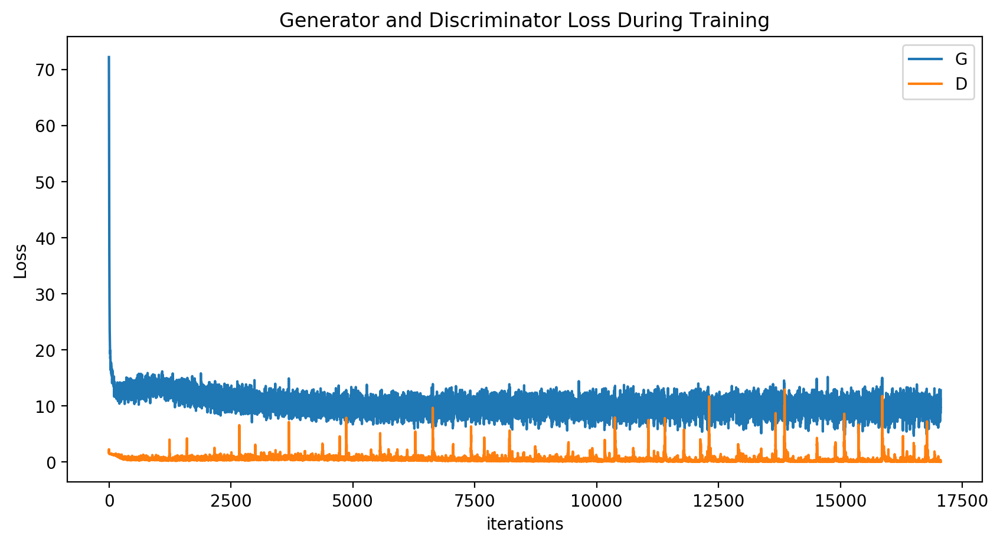

In [21]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(losses_g,label="G")
plt.plot(losses_d,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21080152 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


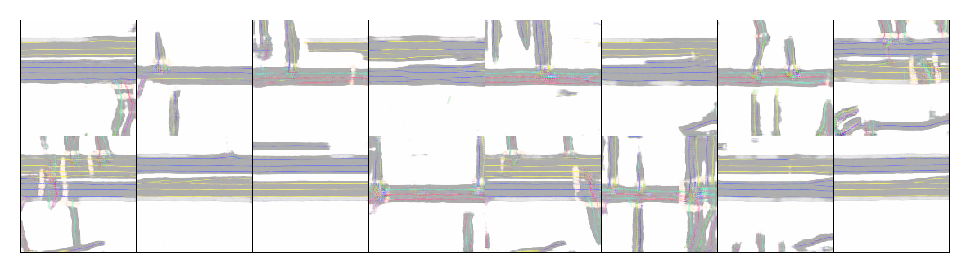

In [22]:
#%%capture
fig = plt.figure(figsize=(6,6))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in intermediate_images]
ani = animation.ArtistAnimation(fig, ims, interval=100, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())

### Evaluate trained generator model on test data (Qualitative)

In [23]:
labeled_testset = LabeledDataset(image_folder=data_dir,
                                  annotation_file=annotation_csv,
                                  scene_index=labeled_scene_index_test,
                                  img_transform=transforms.Compose([transforms.Resize((256,256)),
                                                                    transforms.ToTensor(),
                                                                    transforms.Normalize(mean=(0.5,), std=(0.5,))
                                                                   ]),
                                  map_transform=transforms.Compose([transforms.ToPILImage(),
                                                                    transforms.Resize(256),
                                                                    transforms.ToTensor()
                                                                   ]),
                                  extra_info=True
                                 )

testloader = torch.utils.data.DataLoader(labeled_testset,
                                          batch_size=1,
                                          shuffle=True,
                                          num_workers=2,
                                          collate_fn=collate_fn,
                                          pin_memory=True)

In [24]:
losses_g_L1_eval = []
inference_images = []

generator.eval()

Generator(
  (model): Sequential(
    (0): ReflectionPad2d((3, 3, 3, 3))
    (1): Conv2d(18, 64, kernel_size=(7, 7), stride=(1, 1))
    (2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (3): ReLU(inplace=True)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (8): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (9): ReLU(inplace=True)
    (10): ResnetBlock(
      (resnet_block): Sequential(
        (0): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
        (1): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (2): ReLU(inplace=True)
        (3): Dropout(p=0.5, inplace=False)
        (4): Conv2d(256, 256, kernel_size=(3, 3), strid

In [25]:
####################################
############ INFERENCE #############
####################################

for real_18ch, real_map in tqdm(testloader):
    real_18ch = real_18ch.to(device)
    real_map = real_map.to(device)

    """
    GENERATOR INFERENCE
    """
    gen_map = generator(real_18ch)
    loss_g_L1 = criterion_L1(gen_map, real_map)

    """
    COMPILE TRAINING STATISTICS
    """
    losses_g_L1_eval.append(loss_g_L1.item())
    inference_images.append(np.hstack((real_map.cpu().view([3,256,256]), (gen_map.detach().cpu().view([3,256,256])*0.5) + 0.5)))

100%|██████████| 504/504 [00:27<00:00, 18.51it/s]


Animation size has reached 20990748 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


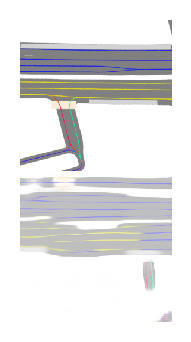

In [26]:
# %%capture
fig = plt.figure(figsize=(4,2))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)).squeeze(), animated=True)] for i in inference_images]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=2000, blit=True)

HTML(ani.to_jshtml())